# Imports

In [1]:
import sys
sys.path.append("..")
sys.path.append("../..")

import os
import numpy as np
import torch
import torchvision.transforms as T
from torchvision.io import read_image
import matplotlib.pyplot as plt
from matplotlib.markers import MarkerStyle
from matplotlib.transforms import Affine2D
import json_tricks as json

from dataset_test import TestImageDataset
from dataset_train import TrainImageDataset

from utils.helper import load_config
from utils.transforms import gt_to_anchorpts
import configs.variables as variables

from helper.transforms import get_affine_transform

from helper.visuals import (showframe, showjoints, 
    showbbox, showlines, visualize, plot_by_joint, annotate_plot, set_title, show, show_grid, set_axis_style)

from helper.predict import (
    adjust_configs, most_recent_checkpoint, sort_checkpoints, load_checkpoint, get_pose, predict_joints, 
    predict, reorder_anchors)

from helper.deepdive import (getBool, get_arms_out, get_arms_down, getStats, compare_models, plot_by_joint_dist)

plt.rcParams["savefig.bbox"] = "tight"
device = torch.device('cuda:0')

# Constants

In [2]:
ROOT_DIR = variables.ROOT_DIR
VOL_DIR = variables.VOL_DIR
CODE_DIR = variables.CODE_DIR
CHECKPOINTS_PREFIX = VOL_DIR + "checkpoints_"
PREPROCESSED_TO_ORIG = variables.PREPROCESSED_TO_ORIG # contains the file path of original frame as well
CONFIGS_DIR = variables.CONFIGS_DIR

TEST_SUBJECTS = ['S9', 'S11']
NORMALIZE = T.Normalize(mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225])

SCALE_FACTOR = 170

METRIC = 0.05

DISTS_DIR = variables.DISTS_DIR

#COLORS = ["#%06x" % x for x in np.linspace(0, 0xFFFFFF, NUM_JOINTS, dtype=int)]

DPI = 300

# Load models and configs, MORE CONSTANTS

In [3]:
from models.model_mse_twostepwarp import Model as model1
from models.model_mse import Model as model2

POSTFIX1 = "mse_natural_flipaugment_twostepwarp"
POSTFIX2 = "mse_natural"

MODEL1 = "+ MSE loss | Natural pose | Two-step warp | Flip augment"
MODEL2 = "+ MSE loss | Natural pose"

CONFIG1_YAML = POSTFIX1 + ".yaml"
CONFIG2_YAML = POSTFIX2 + ".yaml"

CHECKPOINTS_FOLDER1 = CHECKPOINTS_PREFIX + POSTFIX1 + "/"
CHECKPOINTS_FOLDER2 = CHECKPOINTS_PREFIX + POSTFIX2 + "/"

LABELS = np.array(['abdomen', 
          'hipR', 'kneeR', 'ankleR', 
          'hipL', 'kneeL', 'ankleL',
          'chest', 'neck',
          'shoulderR', 'elbowR', 'wristR',
          'shoulderL', 'elbowL', 'wristL'])

SORTED_INDICES = np.array([7, 0, 8,
                        1, 4,
                        9, 12,
                        2, 5,
                        3, 6,
                        10, 13,
                        11, 14])

diamond_rotated = MarkerStyle('d')
diamond_rotated._transform.rotate_deg(90)
MARKERS = np.array(["o", 
           ">", "^", "h", 
           "<", "v", "H", 
           "*", "p", 
           "s", "X", "d",
           "D", "P", diamond_rotated])

POSE_GT = torch.load("pose_collection.pt") # DATASET_LENGTH, NUM_JOINTS, 2
DIAGONAL_GT = torch.load("diagonal_collection.pt") # DATASET_LENGTH

OUT_ANGLE = 20
DOWN_ANGLE = 45

#COLORS = ["#33cccc", "#ff5050", "#9900cc", "#009900", "#ff00ff", "#0080ff", "#333399", "#ff8000"]
COLORS = ["#33cccc", "#ff5050", "#9900cc", "#009900", "#ff00ff", "#0080ff", "#333399", "#ff8000",
            "#00ff00", "#ff00ff", "#ccccff", "#ffff00", "#ff6699", "#ccffcc", "#008080"]

dist1_collection = torch.load(DISTS_DIR + POSTFIX1 + ".pt") # DATASET_LENGTH, NUM_JOINTS
dist2_collection = torch.load(DISTS_DIR + POSTFIX2 + ".pt") # DATASET_LENGTH, NUM_JOINTS

# Qualitative Analysis

In [4]:
# Get configurations of both models
config1 = load_config(CONFIGS_DIR + CONFIG1_YAML)
config2 = load_config(CONFIGS_DIR + CONFIG2_YAML)
# train --> test configurations
adjust_configs(config1)
adjust_configs(config2)

# Instantiate both predictors
predictor1 = model1(config1, device=device)
predictor1.regressor = predictor1.regressor.eval()
predictor1.translator = predictor1.translator.eval()


predictor2 = model2(config2, device=device)
#predictor2 = model2(config2, device=device, num_examples_supervised = 2 * (len(config2['supervision_idxs']) + 5), num_supervised_to_pick = 5)
predictor2.regressor = predictor2.regressor.eval()
predictor2.translator = predictor2.translator.eval()

../utils/helper.py:9: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  cfg = yaml.load(file)
/home/nobliney/.conda/envs/poseestimation/lib/python3.7/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1670525553989/work/aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/nobliney/.conda/envs/poseestimation/lib/python3.7/site-packages/torch/nn/modules/lazy.py:180: UserWarning: Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.
  warnings.warn('Lazy modules are a new feature under heavy development '
/home/nobliney/.conda/envs/poseestimation/lib/python3.7/site-packages/torchvision/models/_utils.py

## Set up test dataset

In [5]:
# Get mapping from preprocessed frame path to corresponding bbox and pose
with open(PREPROCESSED_TO_ORIG, "r") as f:
    preprocessed_to_orig = json.load(f)

In [6]:
dataset = TestImageDataset(transform=NORMALIZE, mapping=preprocessed_to_orig)
DATASET_LENGTH = dataset.length()

Length of Dataset:  134258
Finished initializing dataset.


## Frame reconstruction over time

In [7]:
TIME = 7
NUM_CHECKPOINTS = 50
CHECKPOINT_INDICES = np.linspace(0, NUM_CHECKPOINTS-1, TIME, dtype=int)

#np.random.seed(7)
#TEST_INDICES = np.random.choice(DATASET_LENGTH, 40)
TEST_INDICES = np.array([49689, 99676, 120703])

In [9]:
sorted_checkpoints1 = sort_checkpoints(CHECKPOINTS_FOLDER1)
sorted_checkpoints1 = sorted_checkpoints1[CHECKPOINT_INDICES]

sorted_checkpoints2 = sort_checkpoints(CHECKPOINTS_FOLDER2)
sorted_checkpoints2 = sorted_checkpoints2[CHECKPOINT_INDICES]

In [10]:
def getFrameReconstruction(item_index, sorted_checkpoints1, sorted_checkpoints2):
    get_midpoint = True

    frame1, frame2, bbox1, pose1, frame1_orig_path = dataset.getitem(item_index)
    frame1 = frame1.to(device)
    frame1 = frame1.unsqueeze(dim = 0)
    frame2 = frame2.to(device)
    frame2 = frame2.unsqueeze(dim = 0)
    # Scale down ground truth pose
    bbox1, pose1 = get_pose(bbox1, pose1)
    print("Ground truth")
    visualize(frame1, bbox1, pose1, show_lines = True, show_joints = True, constant = True)
    
    PREDICTOR = predictor1
    CHECKPOINT_FOLDER = CHECKPOINTS_FOLDER1
    SORTED_CHECKPOINTS = sorted_checkpoints1
    print(MODEL1)
    grid = []
    for c in SORTED_CHECKPOINTS:
        load_checkpoint(PREDICTOR, CHECKPOINT_FOLDER + c)
        # Get predicted pose
        anchors, reconstructed, transformed_template = predict(PREDICTOR, frame1, frame2, get_midpoint = get_midpoint)
        grid.append([reconstructed, anchors])
    show_grid(grid, dpi = 500, constant=True)
    
    PREDICTOR = predictor2
    CHECKPOINT_FOLDER = CHECKPOINTS_FOLDER2
    SORTED_CHECKPOINTS = sorted_checkpoints2
    print(MODEL2)
    grid = []
    for c in SORTED_CHECKPOINTS:
        load_checkpoint(PREDICTOR, CHECKPOINT_FOLDER + c)
        # Get predicted pose
        anchors, reconstructed, transformed_template = predict(PREDICTOR, frame1, frame2, get_midpoint = get_midpoint)
        grid.append([reconstructed, anchors])
    show_grid(grid, dpi = 500, constant=True)

    print()
    print()
    

Ground truth


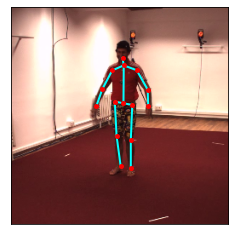

+ lmssim


/home/nobliney/.conda/envs/poseestimation/lib/python3.7/site-packages/kornia/geometry/transform/imgwarp.py:186: UserWarning: The align_corners default value has been changed. By default now is set True in order to match cv2.warpAffine. In case you want to keep your previous behaviour set it to False. This warning will disappear in kornia > v0.6.
  warnings.warn(message)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for f

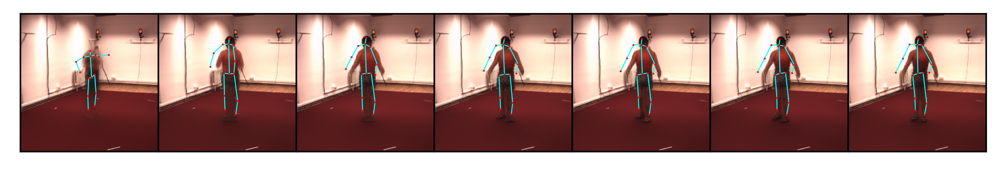

+ dists


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


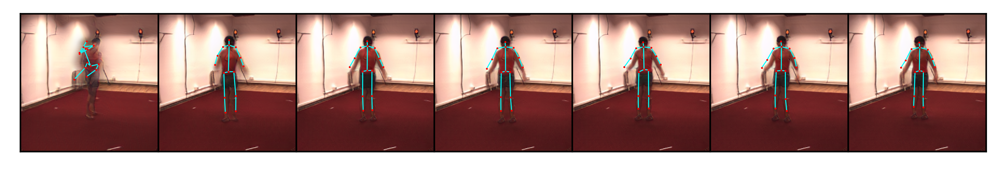

In [11]:
getFrameReconstruction(TEST_INDICES[0], sorted_checkpoints1, sorted_checkpoints2)


Ground truth


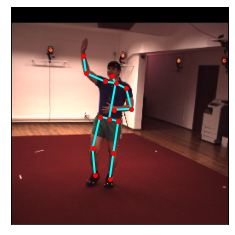

+ lmssim


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


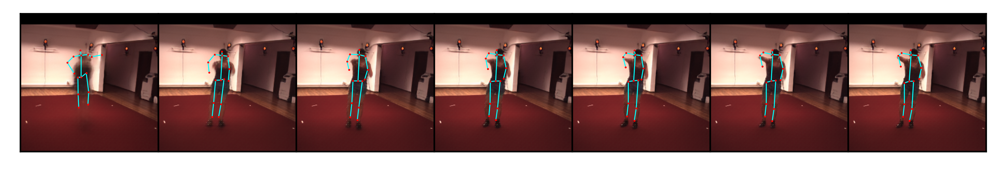

+ dists


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


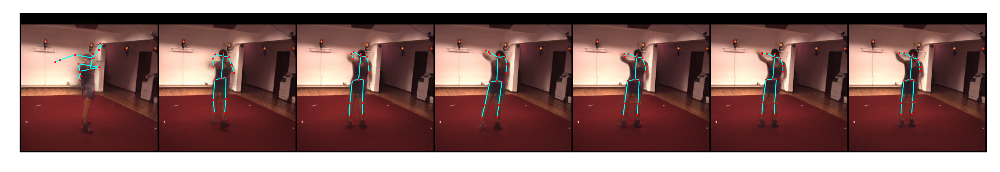

In [12]:
getFrameReconstruction(TEST_INDICES[1], sorted_checkpoints1, sorted_checkpoints2)

Ground truth


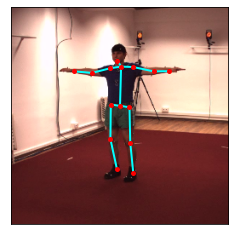

+ lmssim


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


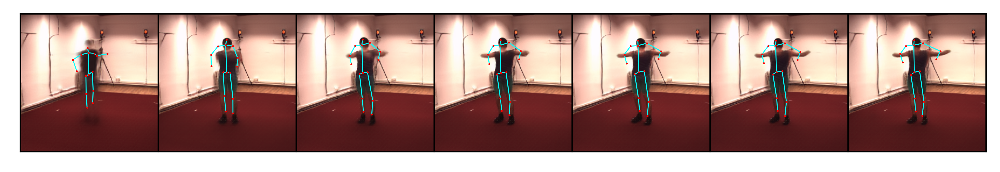

+ dists


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


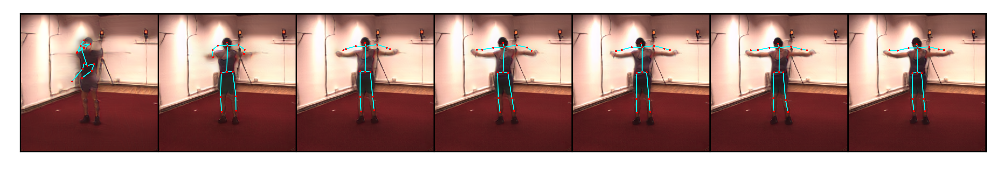

In [13]:
getFrameReconstruction(TEST_INDICES[2], sorted_checkpoints1, sorted_checkpoints2)
print()

## Arms out, down

In [14]:
armsout_indices = get_arms_out(POSE_GT, 20)
armsout_indices = torch.argwhere(armsout_indices).squeeze()

armsdown_indices = get_arms_down(POSE_GT, DOWN_ANGLE)
armsdown_indices = torch.argwhere(armsdown_indices).squeeze()

ARMSOUT_POSE_GT = POSE_GT[armsout_indices,:,:]
ARMSDOWN_POSE_GT = POSE_GT[armsdown_indices,:,:]

np.random.seed(7)
armsout_indices = np.random.choice(armsout_indices.cpu(), 5)
armsdown_indices = np.random.choice(armsdown_indices.cpu(), 5)
#armsout_indices

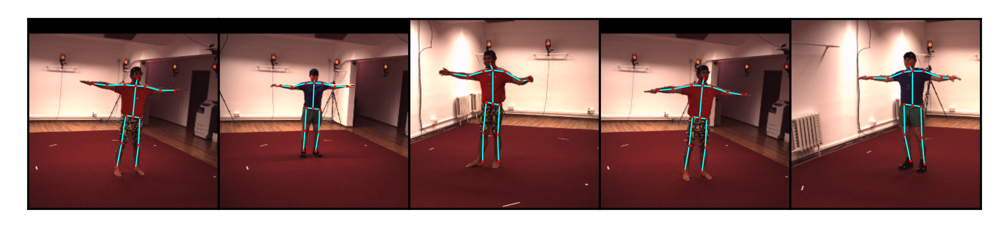

In [15]:
# ARMS OUT
grid = []
for i in armsout_indices:
    frame1, frame2, bbox1, pose1, frame1_orig_path = dataset.getitem(i)
    frame1 = frame1.to(device)
    frame1 = frame1.unsqueeze(dim = 0)
    frame2 = frame2.to(device)
    frame2 = frame2.unsqueeze(dim = 0)
    # Scale down ground truth pose
    bbox1, pose1 = get_pose(bbox1, pose1)
    grid.append([frame1, pose1])
show_grid(grid, dpi=500)

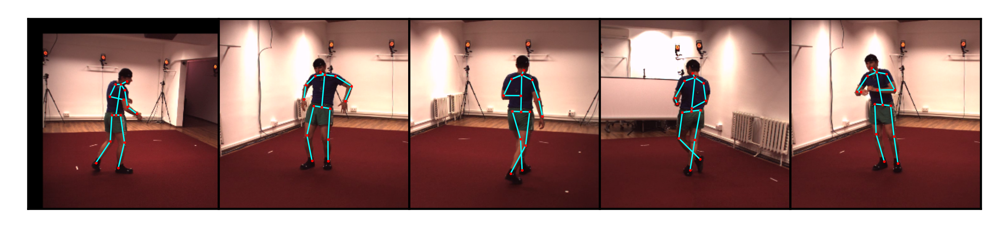

In [16]:
# ARMS DOWN
grid = []
for i in armsdown_indices:
    frame1, frame2, bbox1, pose1, frame1_orig_path = dataset.getitem(i)
    frame1 = frame1.to(device)
    frame1 = frame1.unsqueeze(dim = 0)
    frame2 = frame2.to(device)
    frame2 = frame2.unsqueeze(dim = 0)
    # Scale down ground truth pose
    bbox1, pose1 = get_pose(bbox1, pose1)
    grid.append([frame1, pose1])
show_grid(grid, dpi=500)

## Comparison

In [17]:
TIME = 7
NUM_CHECKPOINTS = 50

CHECKPOINT_INDICES = np.linspace(0, NUM_CHECKPOINTS-1, TIME, dtype=int)
#np.random.seed(7)
#TEST_INDICES = np.random.choice(DATASET_LENGTH, 40)
TEST_INDICES = np.array([49689, 99676, 120703, 16553, 61615, 53459])

In [18]:
recent_checkpoint1 = most_recent_checkpoint(CHECKPOINTS_FOLDER1)
recent_checkpoint2 = most_recent_checkpoint(CHECKPOINTS_FOLDER2)


In [19]:
def compareAcrossCases(test_indices, recent_checkpoint1, recent_checkpoint2):
    # Ground truth
    grid_GT = []
    grid1 = []
    grid2 = []
    get_midpoint = True
    for i in test_indices:
        frame1, frame2, bbox1, pose1, frame1_orig_path = dataset.getitem(i)
        frame1 = frame1.to(device)
        frame1 = frame1.unsqueeze(dim = 0)
        frame2 = frame2.to(device)
        frame2 = frame2.unsqueeze(dim = 0)
        # Scale down ground truth pose
        bbox1, pose1 = get_pose(bbox1, pose1)
        grid_GT.append([frame1, pose1])
        
        load_checkpoint(predictor1, CHECKPOINTS_FOLDER1 + recent_checkpoint1)

        anchors, reconstructed, transformed_template = predict(predictor1, frame1, frame2, get_midpoint = get_midpoint)
        
        grid1.append([frame1, anchors])
        
        load_checkpoint(predictor2, CHECKPOINTS_FOLDER2 + recent_checkpoint2)
        
        anchors, reconstructed, transformed_template = predict(predictor2, frame1, frame2, get_midpoint = get_midpoint)

        grid2.append([frame1, anchors])


    show_grid(grid_GT, dpi=500, constant=True)
    show_grid(grid1, dpi = 500, constant=True)
    show_grid(grid2, dpi = 500, constant=True)

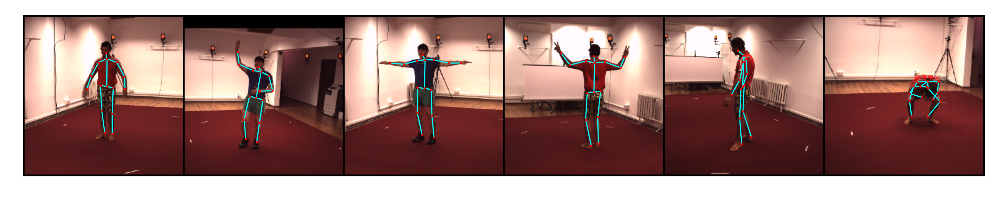

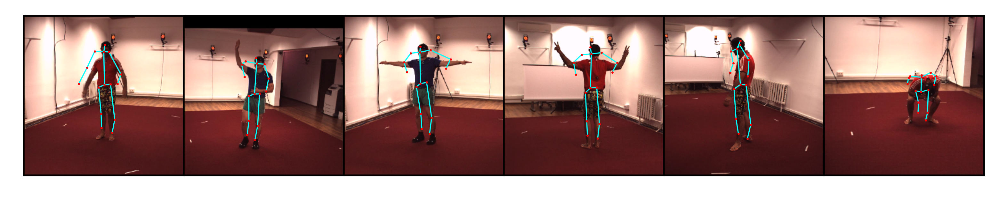

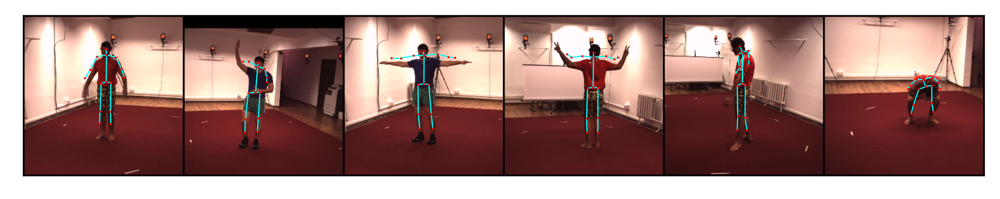

In [20]:
compareAcrossCases(TEST_INDICES, recent_checkpoint1, recent_checkpoint2)

## Best, worst predictions

In [21]:
num_examples = 5
top_div = 0.01 # 10

# use top top_div%
view_indices = torch.linspace(0, DATASET_LENGTH * top_div / 100, num_examples, dtype=int)

In [22]:
def getBestWorst(dists, diagonals, predictor, checkpoint_path, model):
    pdj_by_joint, pdj_by_frame, pdj_overall, error_by_joint, error_by_frame, error_overall = getStats(dists, diagonals)

    # the best
    sorted_indices_by_best = torch.argsort(error_by_frame)
    sorted_indices_by_worst = torch.argsort(-error_by_frame)

    sorted_indices_by_best = sorted_indices_by_best[view_indices]
    sorted_indices_by_worst = sorted_indices_by_worst[view_indices]
    
    print(model)

    load_checkpoint(predictor, checkpoint_path)
    
    get_midpoint = True
    grid = []
    for i in sorted_indices_by_best:
        frame1, frame2, bbox1, pose1, frame1_orig_path = dataset.getitem(i)
        frame1 = frame1.to(device)
        frame1 = frame1.unsqueeze(dim = 0)
        frame2 = frame2.to(device)
        frame2 = frame2.unsqueeze(dim = 0)

        # Scale down ground truth pose
        #bbox1, pose1 = get_pose(bbox1, pose1)

        # Get predicted pose
        anchors, reconstructed, transformed_template = predict(predictor, frame1, frame2, get_midpoint = get_midpoint)

        grid.append([frame1, anchors])

    show_grid(grid, dpi = 500)  

    grid = []
    for i in sorted_indices_by_worst:
        frame1, frame2, bbox1, pose1, frame1_orig_path = dataset.getitem(i)
        frame1 = frame1.to(device)
        frame1 = frame1.unsqueeze(dim = 0)
        frame2 = frame2.to(device)
        frame2 = frame2.unsqueeze(dim = 0)

        # Get predicted pose
        anchors, reconstructed, transformed_template = predict(predictor, frame1, frame2, get_midpoint = get_midpoint)

        grid.append([frame1, anchors])

    show_grid(grid, dpi = 500)     

+ lmssim


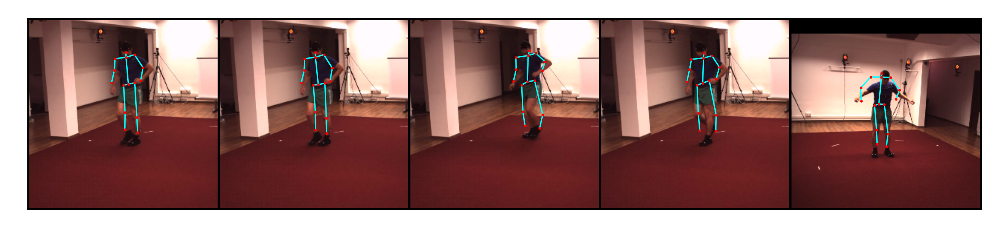

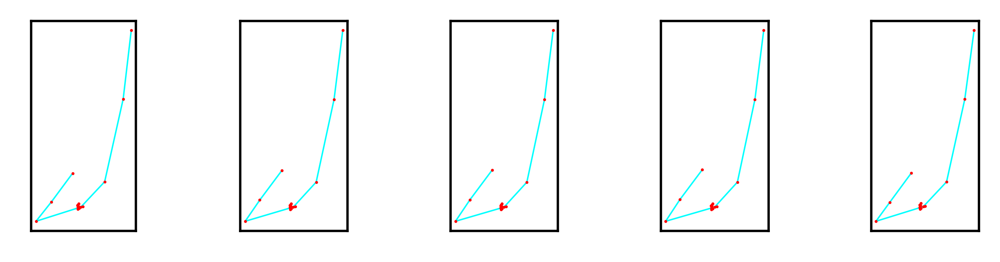

In [23]:
# PREDICTOR 1
getBestWorst(dist1_collection, DIAGONAL_GT, predictor1, CHECKPOINTS_FOLDER1 + recent_checkpoint1, MODEL1)

+ dists


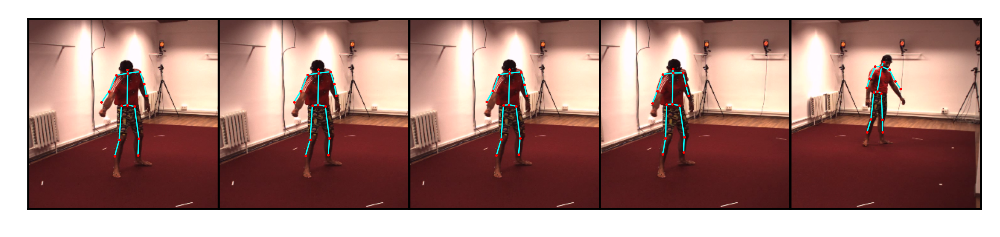

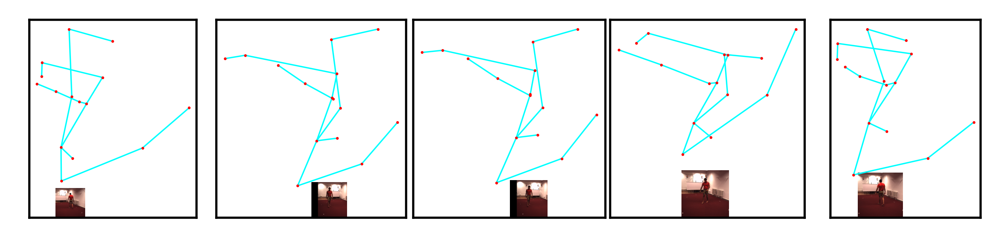

In [24]:
# PREDICTOR 2
getBestWorst(dist2_collection, DIAGONAL_GT, predictor2, CHECKPOINTS_FOLDER2 + recent_checkpoint2, MODEL2)